In [1]:
from google.colab import drive
drive.mount('/content/drive')

%cd /content/drive/MyDrive/codespace/ann-2022-project
%pwd

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
/content/drive/MyDrive/codespace/ann-2022-project


'/content/drive/MyDrive/codespace/ann-2022-project'

In [2]:
!pip install -q tensorflow-addons
!pip install -q wandb

In [3]:
import random
import matplotlib.pyplot as plt
from sklearn.metrics import classification_report, confusion_matrix

import tensorflow as tf

from src import load_pretrained_googlenet, load_train_dataset, Configuration
from src.xai import visualize

## Scratch No Augmentation / Hard Augmentation case

In [4]:
config = Configuration()
tf.random.set_seed(42)

In [5]:
train_ds, valid_ds = load_train_dataset(config)

Found 1179 files belonging to 2 classes.
Using 944 files for training.
Found 1179 files belonging to 2 classes.
Using 235 files for validation.


In [31]:
def run_dataset(model, valid_ds):
  
  all_eyes, all_labels, all_preds = [], [], []

  correct_eyes, correct_labels, correct_preds = [], [], []
  wrong_eyes, wrong_labels, wrong_preds = [], [], []

  for eyes, labels in valid_ds:

      labels = labels.numpy()
      preds = (model.predict(eyes) > 0.5).astype(int).reshape(-1)

      all_eyes.append(eyes)
      all_labels.append(labels)
      all_preds.append(preds)

      for idx, (_label, _pred) in enumerate(zip(labels, preds)):
          _eye = tf.expand_dims(eyes[idx], axis=0)
          if _label != _pred:
              wrong_eyes.append(_eye)
              wrong_labels.append(labels[idx])
              wrong_preds.append(preds[idx])
          else:
              correct_eyes.append(_eye)
              correct_labels.append(labels[idx])
              correct_preds.append(preds[idx])

  all_eyes = tf.concat(all_eyes, axis=0)
  all_labels = tf.concat(all_labels, axis=0)
  all_preds = tf.concat(all_preds, axis=0)

  correct_eyes = tf.concat(correct_eyes, axis=0)
  correct_labels = tf.concat(correct_labels, axis=0)
  correct_preds = tf.concat(correct_preds, axis=0)

  wrong_eyes = tf.concat(wrong_eyes, axis=0)
  wrong_labels = tf.concat(wrong_labels, axis=0)
  wrong_preds = tf.concat(wrong_preds, axis=0)

  cf_matrix = confusion_matrix(all_labels.numpy(), all_preds.numpy())
  clf_report = classification_report(all_labels.numpy(), all_preds.numpy())
  print(cf_matrix)
  print(clf_report)

  # False Positive
  try:
    fp_eyes = wrong_eyes[wrong_preds == 1]
    fp_preds = wrong_preds[wrong_preds == 1] # label = 0
  except:
    fp_eyes, fp_preds = None, None

  # True Negative
  try:
    tn_eyes = wrong_eyes[wrong_preds == 0]
    tn_preds = wrong_preds[wrong_preds == 0] # label = 1
  except:
    tn_eyes, tn_preds = None, None

  negatives = correct_eyes[correct_labels == 0]
  positives = correct_eyes[correct_labels == 1]

  return {
      "negatives": negatives,
      "positives": positives,
      "fp_eyes": fp_eyes,
      "tn_eyes": tn_eyes
  }

# Visualization

I just used naive GradCAM and GuidedBackprop to understand the models

In [7]:
def get_maps(model, img):
  layers = list(filter(lambda name: name.startswith("mixed"), [l.name for l in model.layers]))

  gcam, gbp = visualize(model, img, "concatenate")
  gcams = [visualize(model, img, layer_name)[0] for layer_name in layers]
  gcams = [gcam] + gcams
  return gcams, gbp

def plot_gcams(gcams):

  fig, ax = plt.subplots(nrows=3, ncols=3, figsize=(10, 10))

  for idx in range(9):

    row, col = idx // 3, idx % 3
    ax[row][col].imshow(gcams[idx])
    ax[row][col].grid(False);
    ax[row][col].axis("off");

def plot_gbp(input_img, gbp):

  fig, ax = plt.subplots(ncols=2, figsize=(12, 6))

  ax[0].imshow(input_img);
  ax[0].grid(False);
  ax[0].axis("off");

  ax[1].imshow(gbp);
  ax[1].grid(False);
  ax[1].axis("off");

In [8]:
def plot_xais(model, eyes, description):

  print(f"{description}: ", end="")
  for idx in random.sample(range(len(eyes)), min(3, len(eyes))):

    print(f"{idx} ", end="")
    input_img = eyes[idx]
    gcams, gbp = get_maps(model, input_img)

    plot_gbp(input_img, gbp)
    plot_gcams(gcams)
  print()

## Scratch, No augmentation

In [9]:
config = Configuration()
tf.random.set_seed(49)
tf.keras.backend.clear_session()

config.use_augmentation = False
config.use_pretrained = False
config.linear_probing = False
model = load_pretrained_googlenet(config)
model_path = "./models/scratch_noaug"
model.load_weights(model_path)

In [10]:
classified_eyes = run_dataset(model, valid_ds)

[[111   5]
 [  3 116]]
              precision    recall  f1-score   support

           0       0.97      0.96      0.97       116
           1       0.96      0.97      0.97       119

    accuracy                           0.97       235
   macro avg       0.97      0.97      0.97       235
weighted avg       0.97      0.97      0.97       235



negatives: 45 12 42 


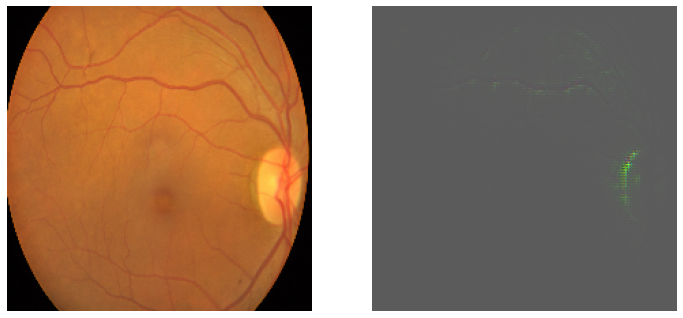

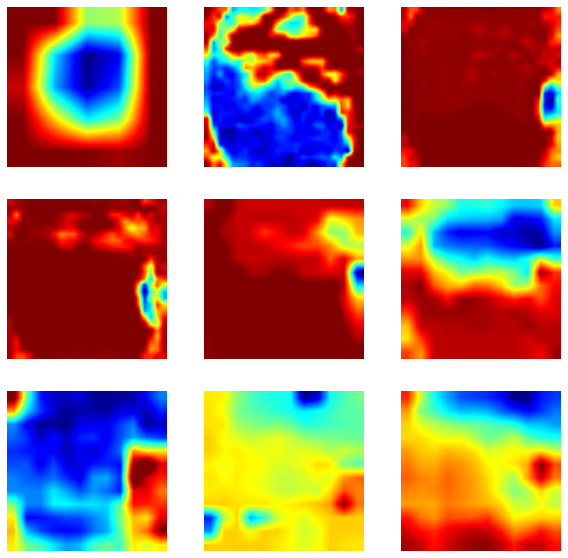

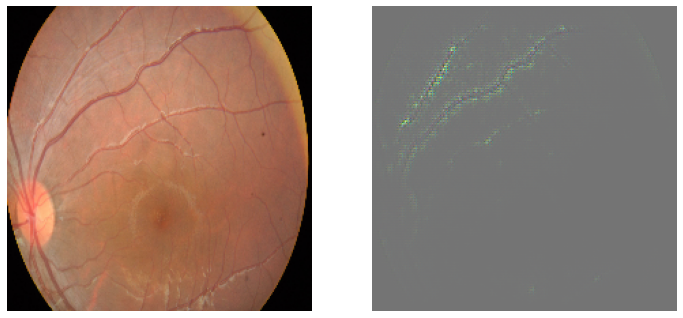

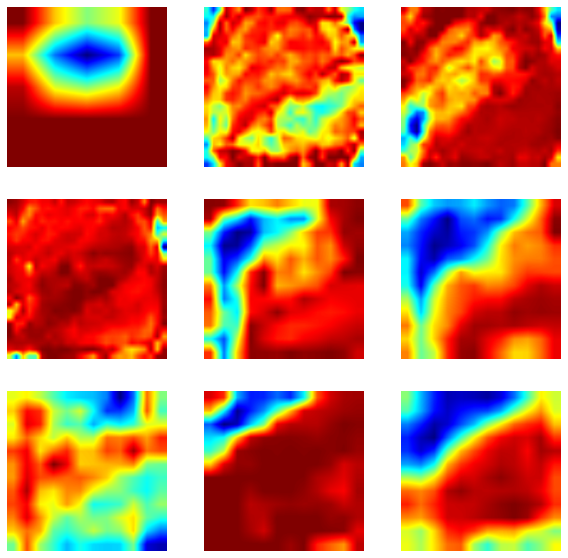

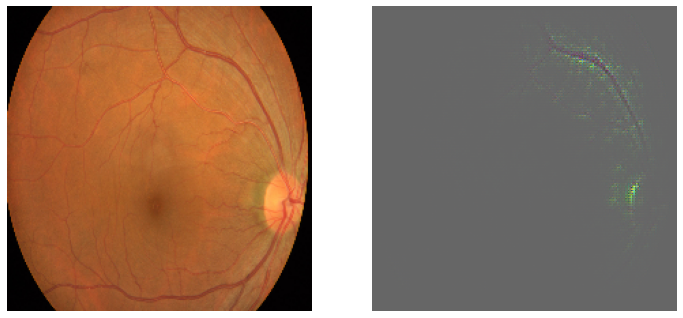

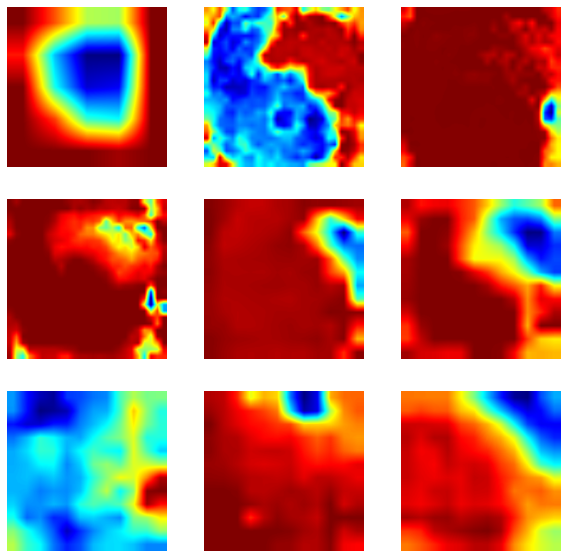

In [11]:
tf.random.set_seed(49)
tf.keras.backend.clear_session()
plot_xais(model, classified_eyes["negatives"], "negatives")

positives: 102 34 63 


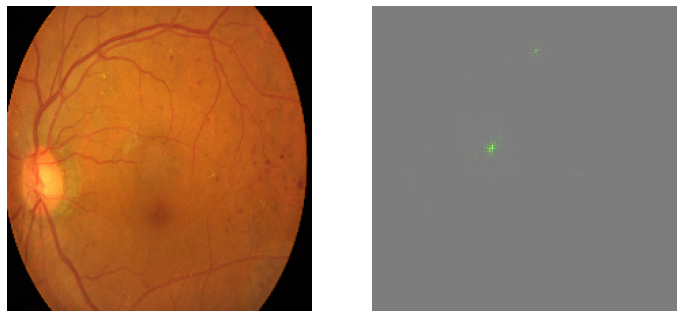

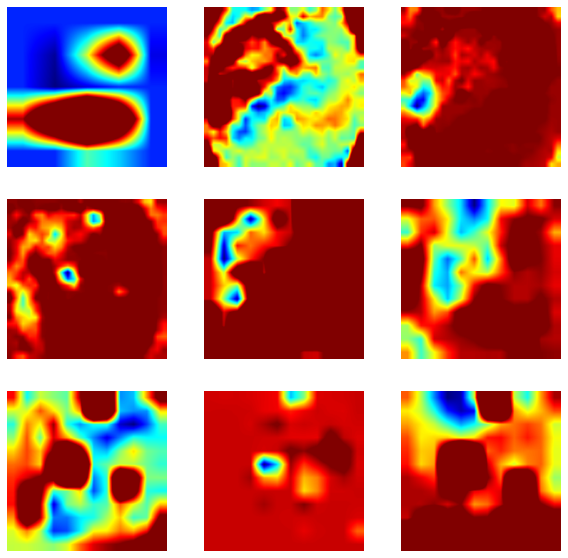

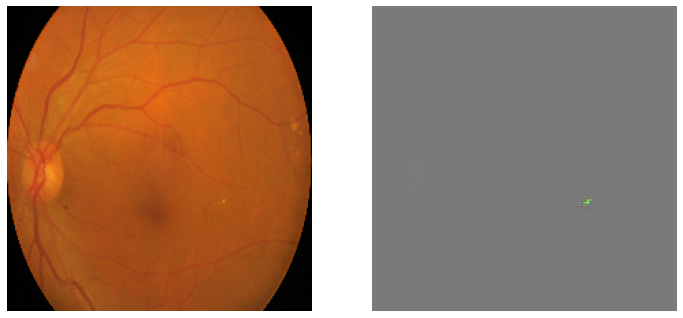

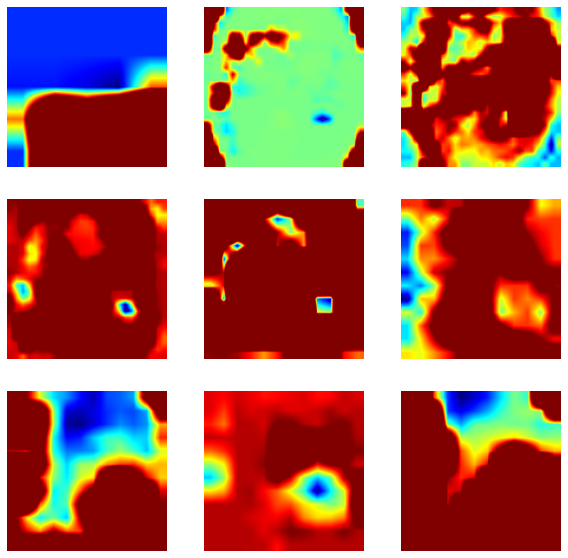

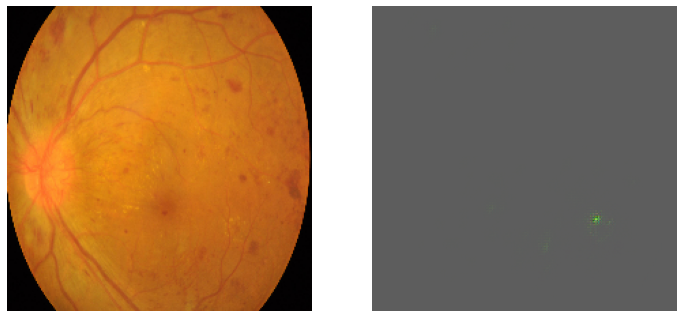

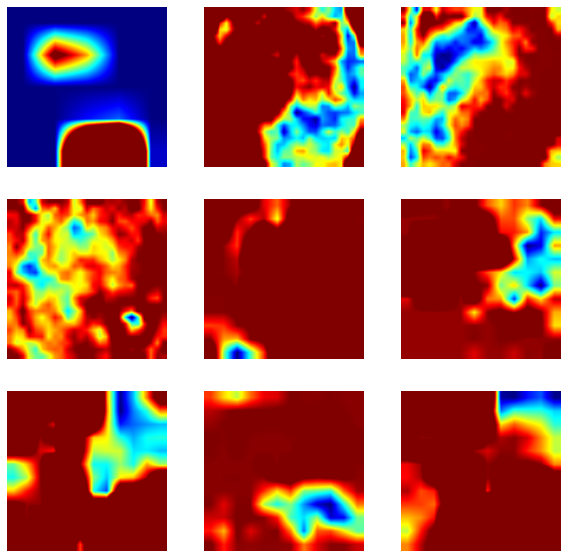

In [12]:
tf.random.set_seed(49)
tf.keras.backend.clear_session()
plot_xais(model, classified_eyes["positives"], "positives",)

fp_eyes: 2 3 0 


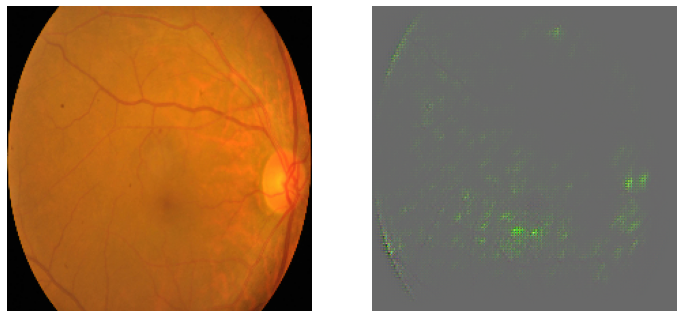

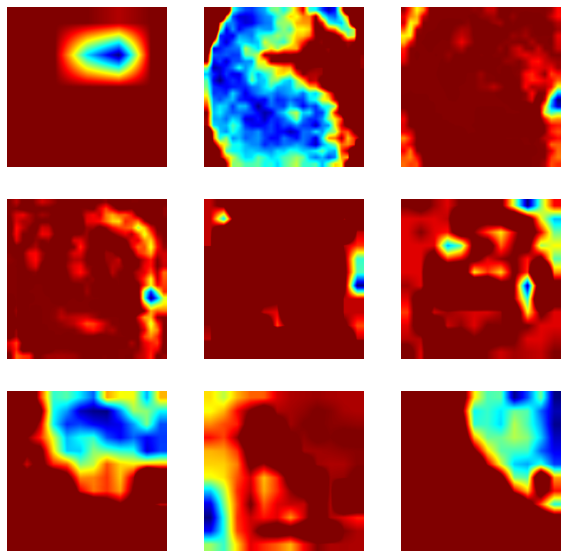

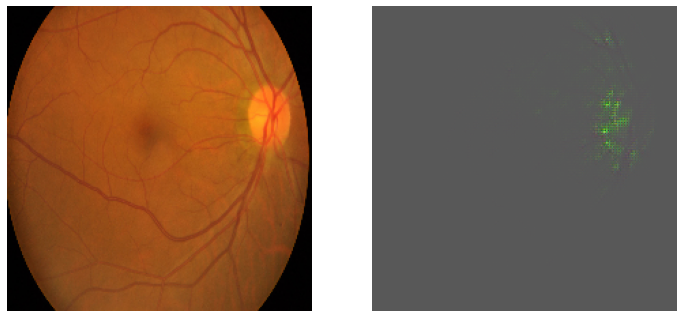

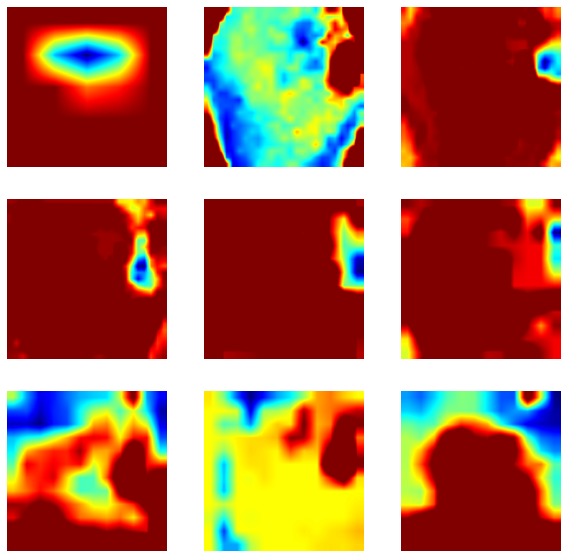

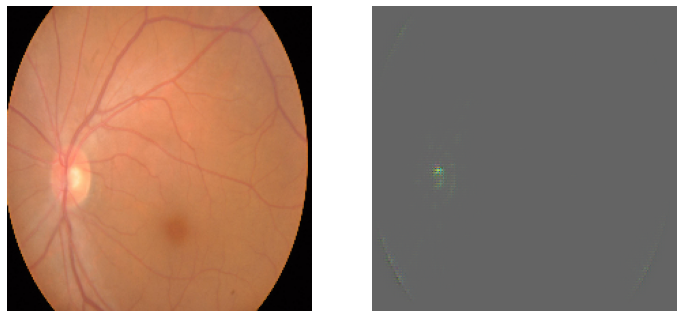

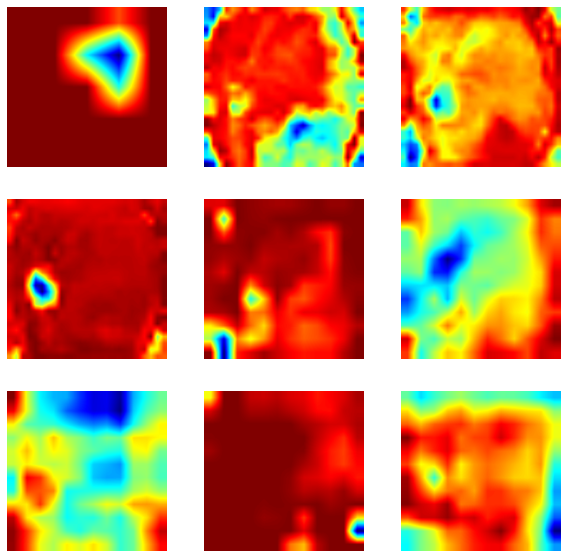

In [13]:
tf.random.set_seed(49)
tf.keras.backend.clear_session()
plot_xais(model, classified_eyes["fp_eyes"], "fp_eyes")

tn_eyes: 1 0 2 


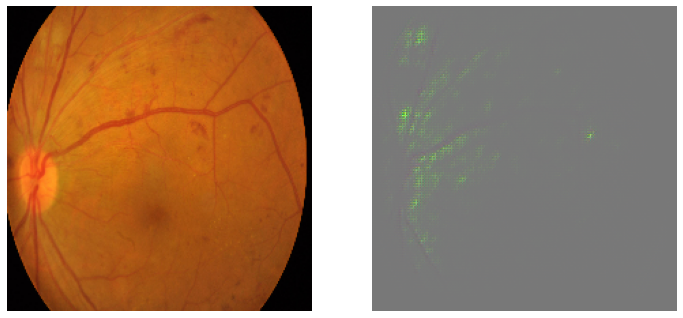

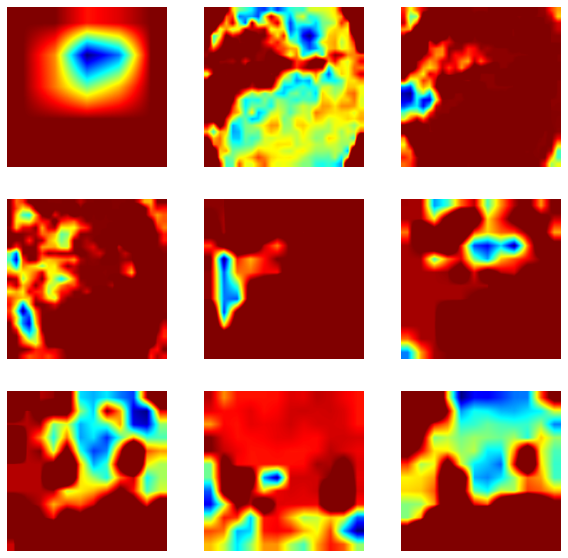

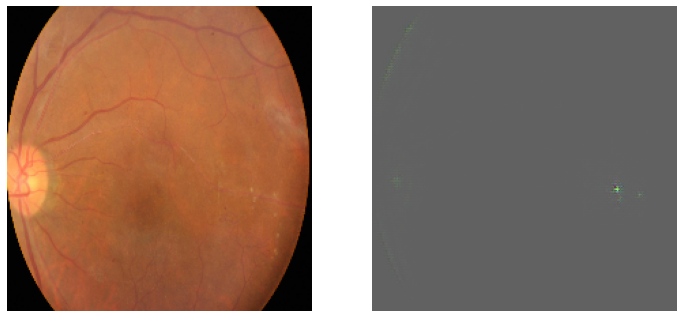

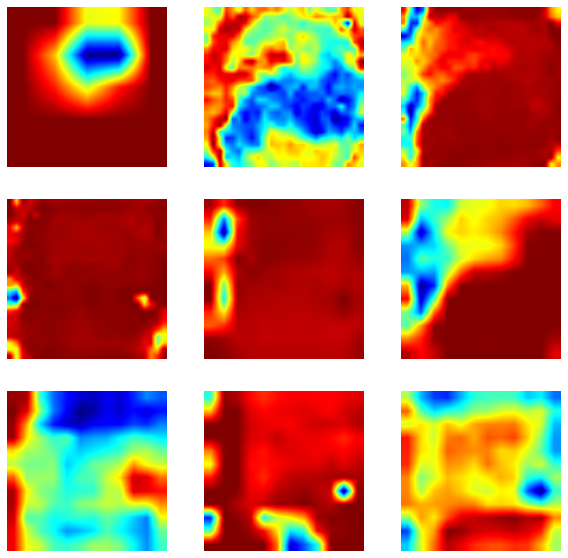

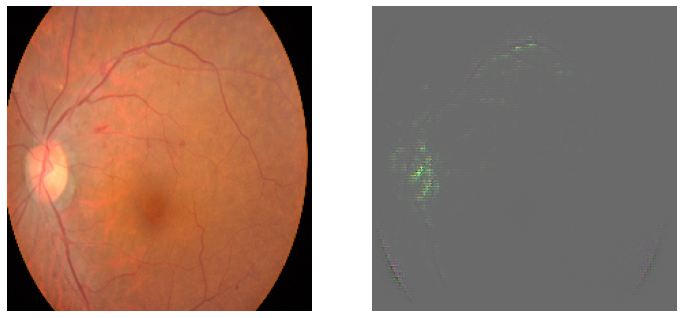

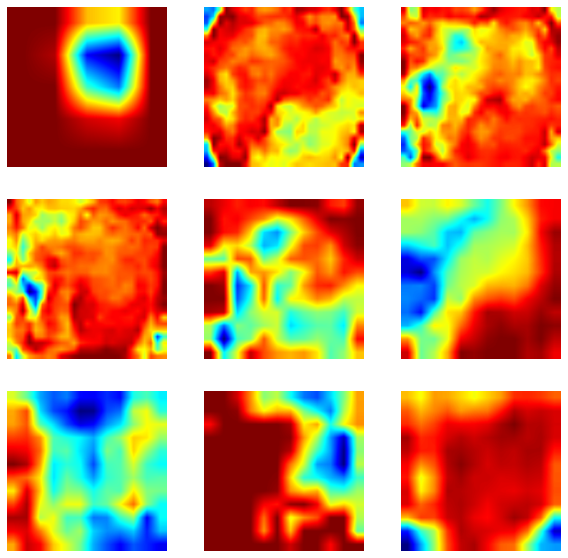

In [14]:
tf.random.set_seed(49)
tf.keras.backend.clear_session()
plot_xais(model, classified_eyes["tn_eyes"], "tn_eyes")

## Scratch, Hard Augmentation

In [15]:
config = Configuration()
tf.random.set_seed(46)
tf.keras.backend.clear_session()

config.use_augmentation = "hard"
config.use_pretrained = False
config.linear_probing = False
model = load_pretrained_googlenet(config)
model_path = "./models/scratch_hardaug"
model.load_weights(model_path)

classified_eyes = run_dataset(model, valid_ds)

[[110   6]
 [  7 112]]
              precision    recall  f1-score   support

           0       0.94      0.95      0.94       116
           1       0.95      0.94      0.95       119

    accuracy                           0.94       235
   macro avg       0.94      0.94      0.94       235
weighted avg       0.94      0.94      0.94       235



negatives: 84 61 41 


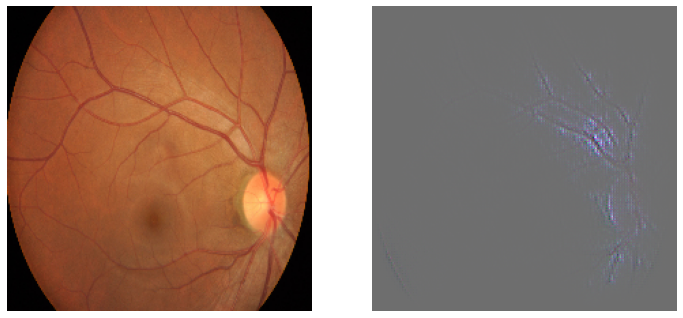

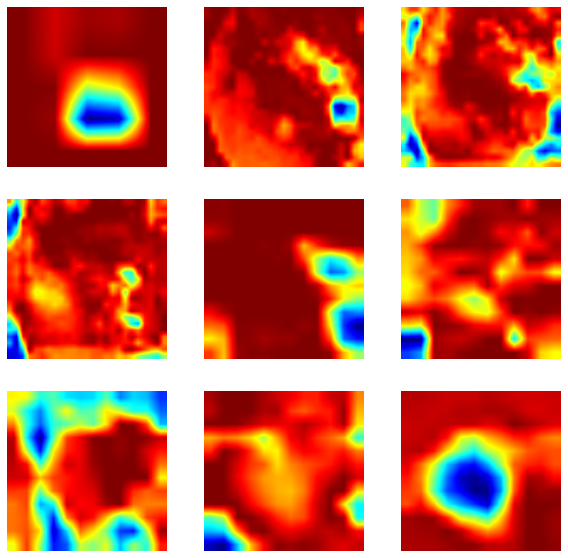

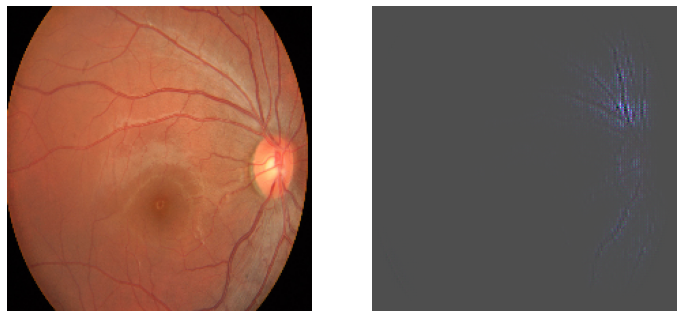

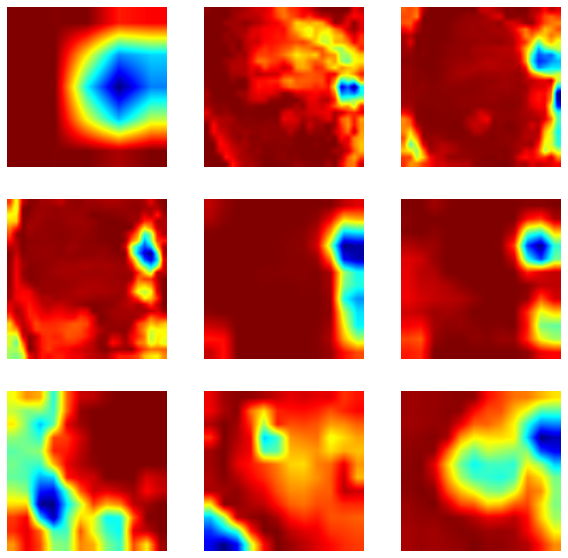

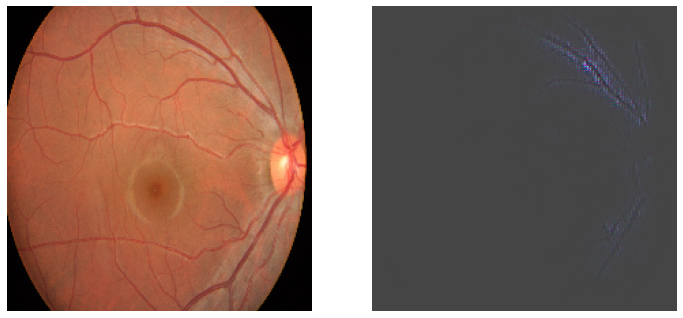

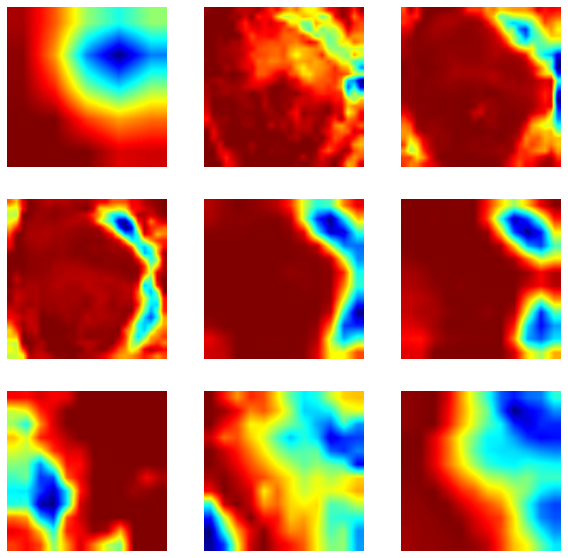

In [16]:
tf.random.set_seed(46)
tf.keras.backend.clear_session()
plot_xais(model, classified_eyes["negatives"], "negatives")

positives: 94 

/content/drive/MyDrive/codespace/ann-2022-project/src/xai.py:39: RuntimeWarning: invalid value encountered in true_divide
  heatmap = (grad_cam_img - grad_cam_img.min()) / (grad_cam_img.max() - grad_cam_img.min())


31 51 


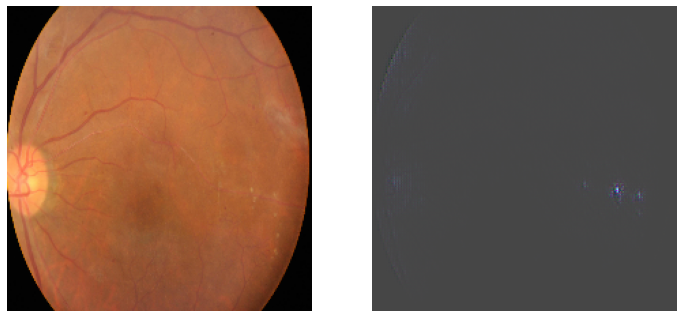

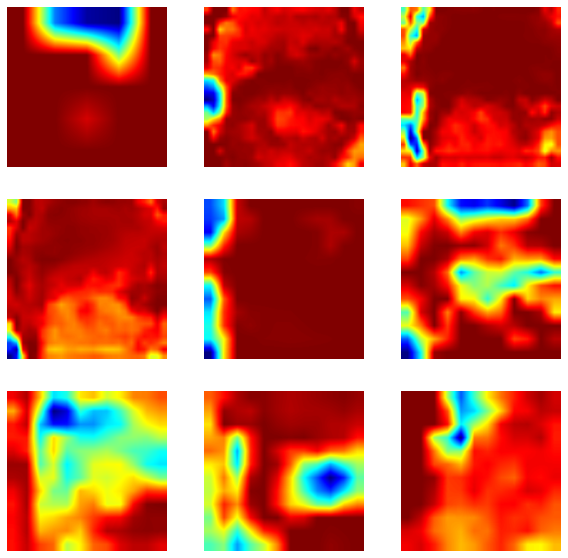

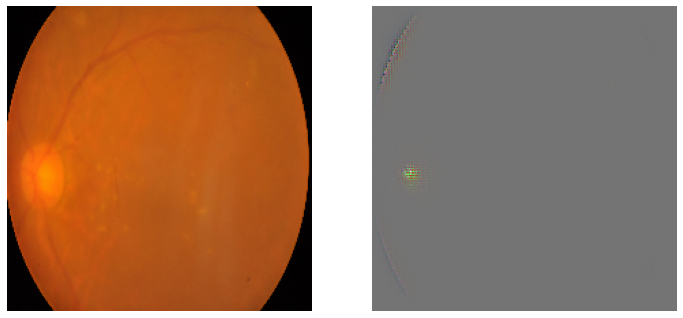

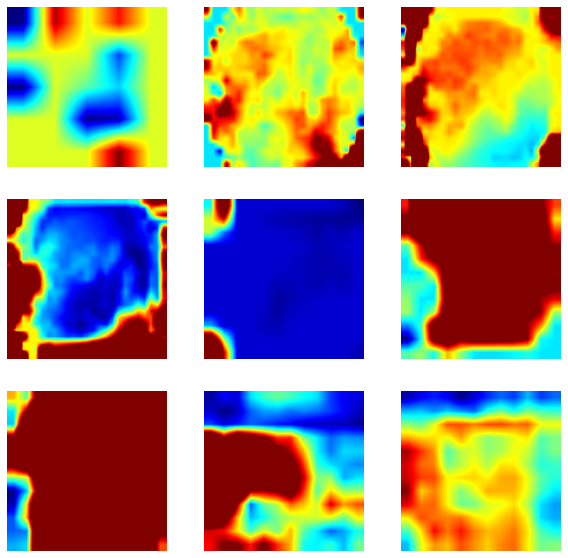

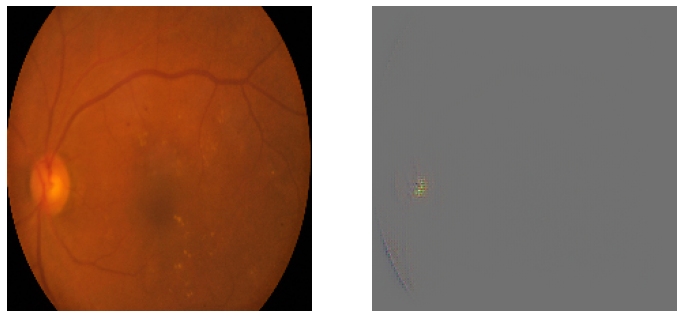

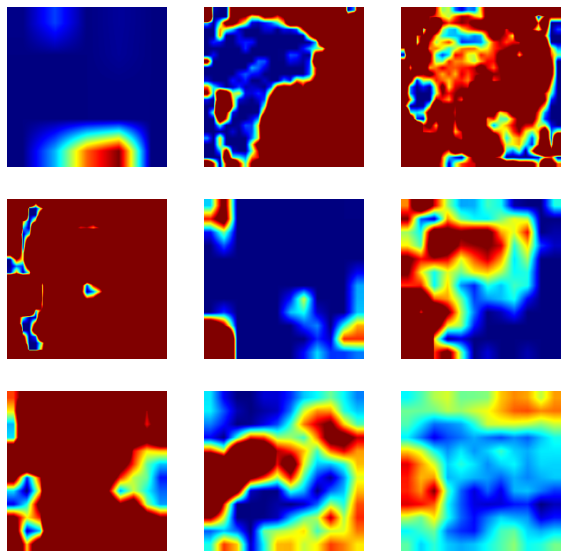

In [17]:
tf.random.set_seed(46)
tf.keras.backend.clear_session()
plot_xais(model, classified_eyes["positives"], "positives",)

fp_eyes: 4 1 

/content/drive/MyDrive/codespace/ann-2022-project/src/xai.py:39: RuntimeWarning: invalid value encountered in true_divide
  heatmap = (grad_cam_img - grad_cam_img.min()) / (grad_cam_img.max() - grad_cam_img.min())


0 


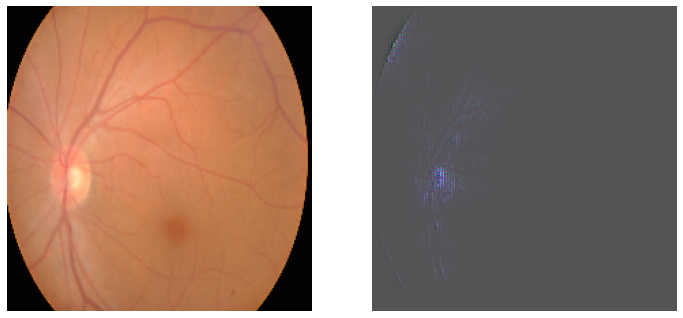

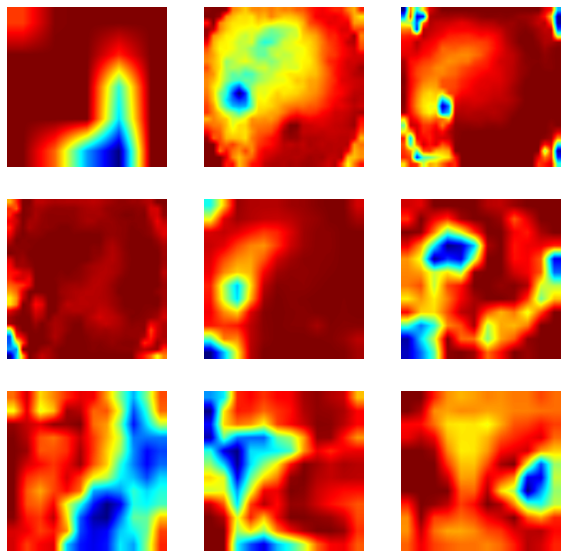

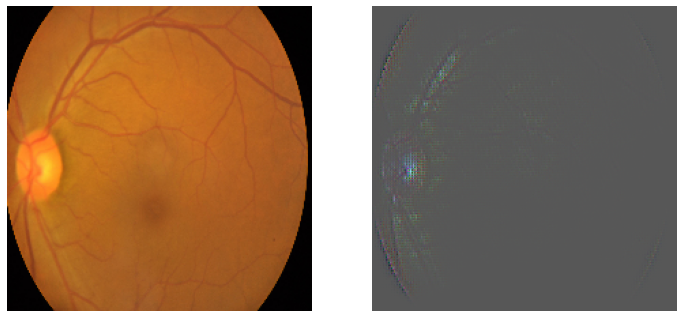

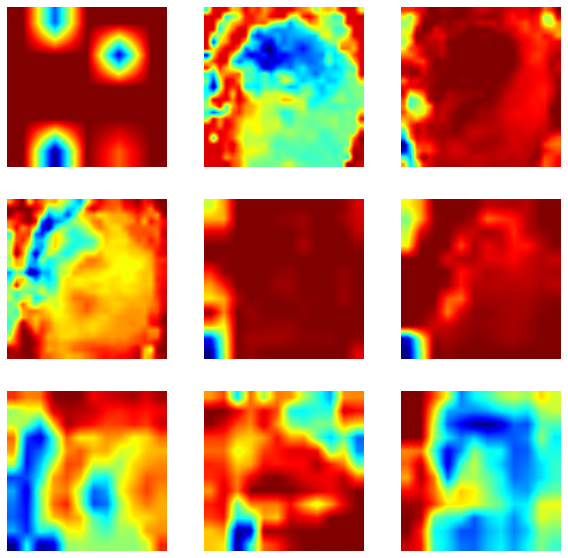

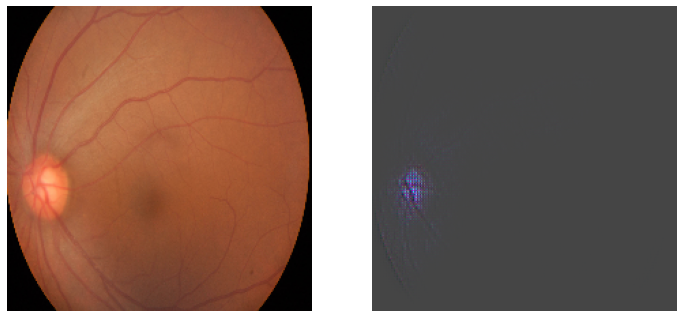

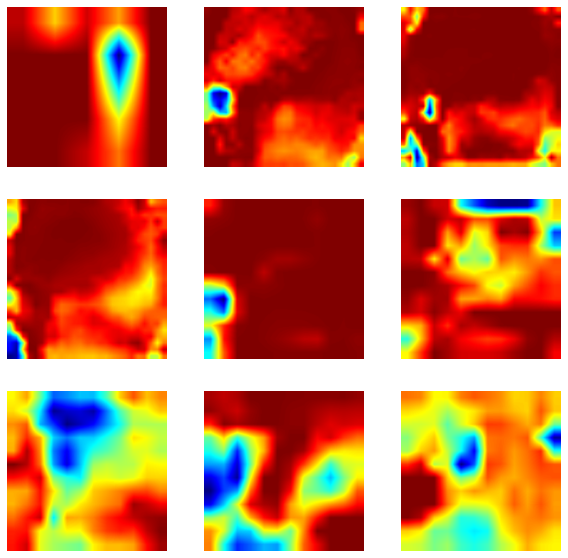

In [18]:
tf.random.set_seed(46)
tf.keras.backend.clear_session()
plot_xais(model, classified_eyes["fp_eyes"], "fp_eyes")

tn_eyes: 3 4 5 


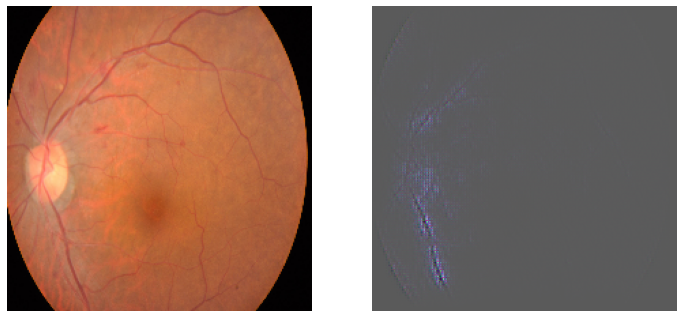

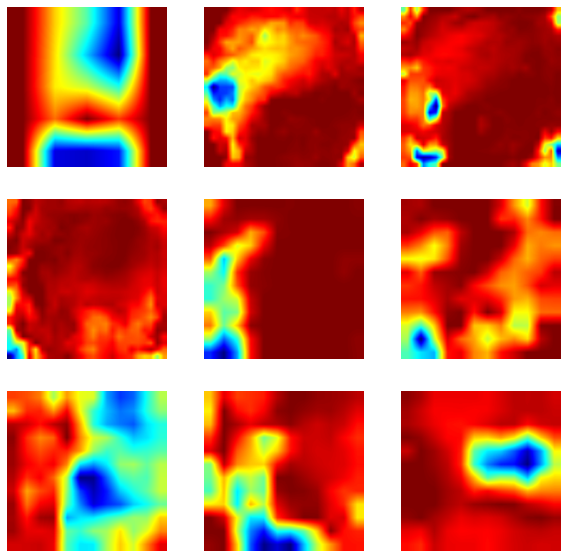

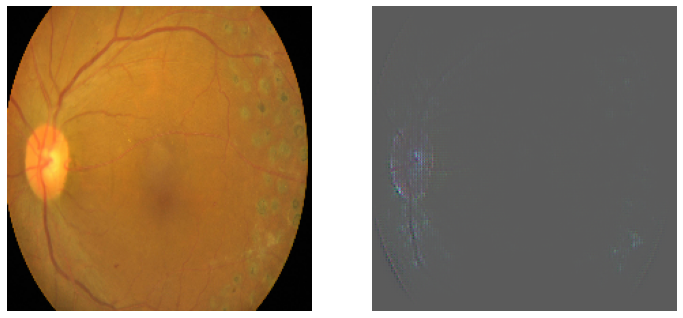

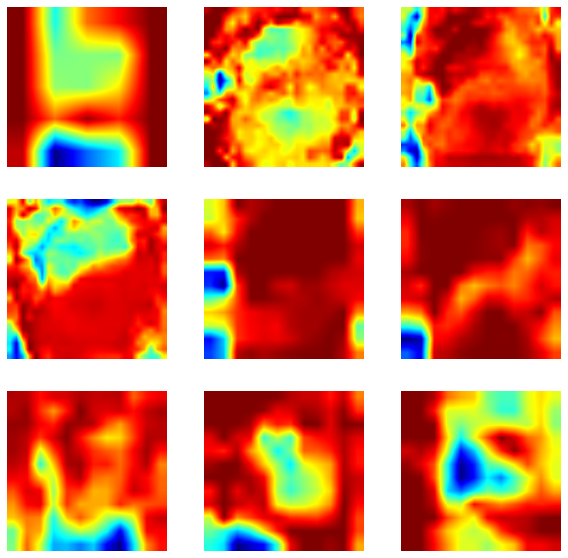

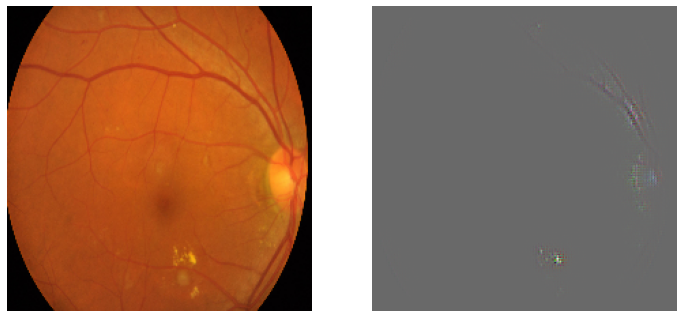

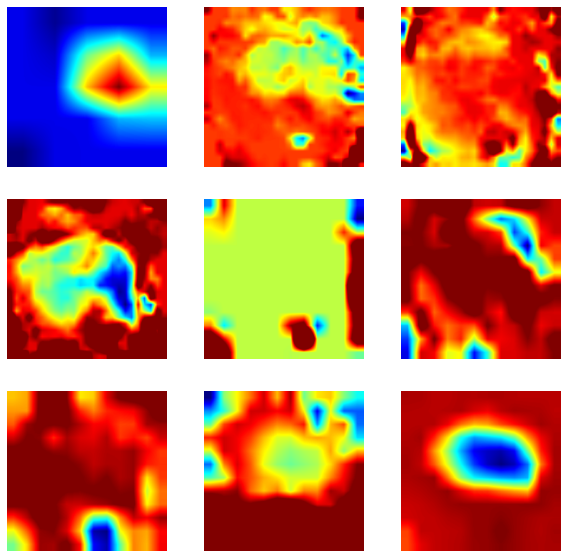

In [19]:
tf.random.set_seed(46)
tf.keras.backend.clear_session()
plot_xais(model, classified_eyes["tn_eyes"], "tn_eyes")

## Linear Probing

In [20]:
config = Configuration()
tf.random.set_seed(45)
tf.keras.backend.clear_session()

config.use_augmentation = False
config.use_pretrained = True
config.linear_probing = True
model = load_pretrained_googlenet(config)
model_path = "./models/linear_noaug"
model.load_weights(model_path)

classified_eyes = run_dataset(model, valid_ds)

87924736/87910968 [==============================] - 1s 0us/step
[[112   4]
 [  4 115]]
              precision    recall  f1-score   support

           0       0.97      0.97      0.97       116
           1       0.97      0.97      0.97       119

    accuracy                           0.97       235
   macro avg       0.97      0.97      0.97       235
weighted avg       0.97      0.97      0.97       235



negatives: 109 

/content/drive/MyDrive/codespace/ann-2022-project/src/xai.py:39: RuntimeWarning: invalid value encountered in true_divide
  heatmap = (grad_cam_img - grad_cam_img.min()) / (grad_cam_img.max() - grad_cam_img.min())


13 97 


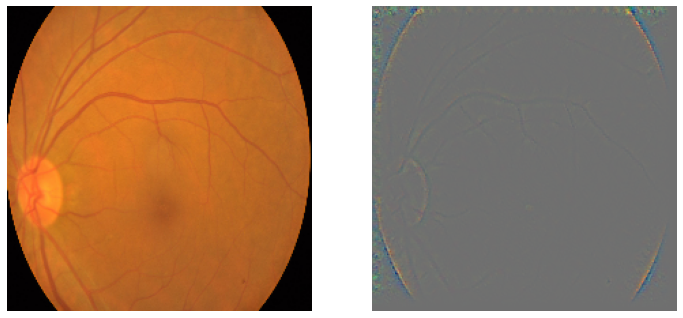

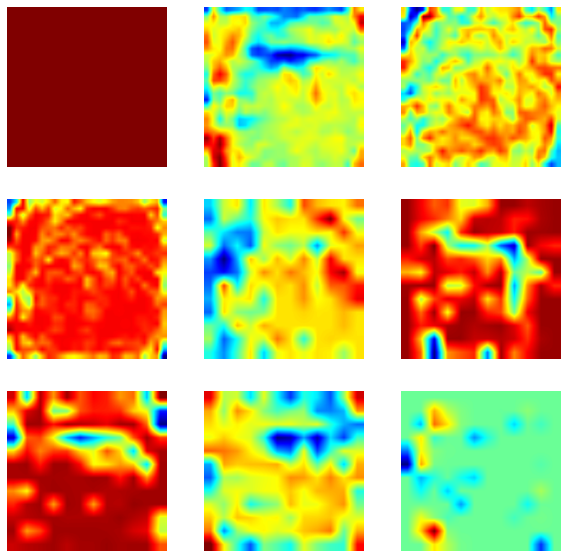

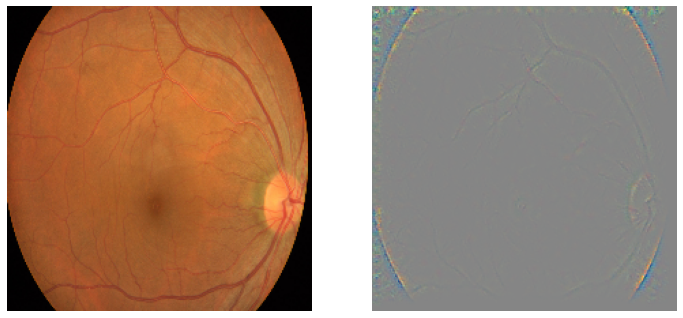

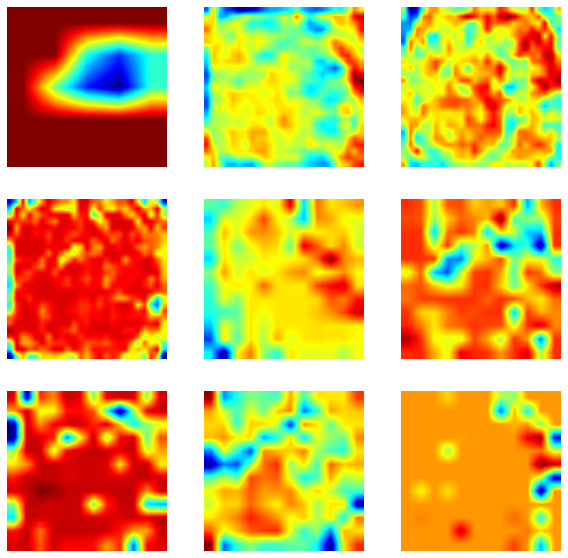

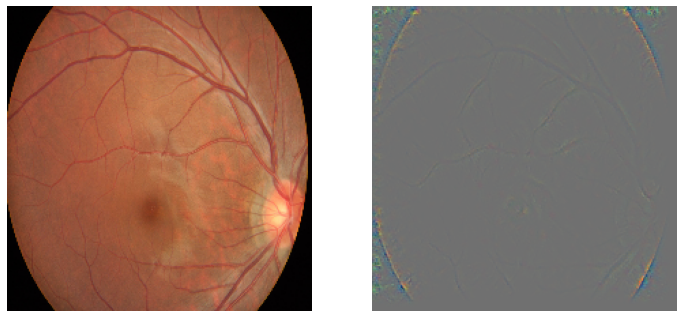

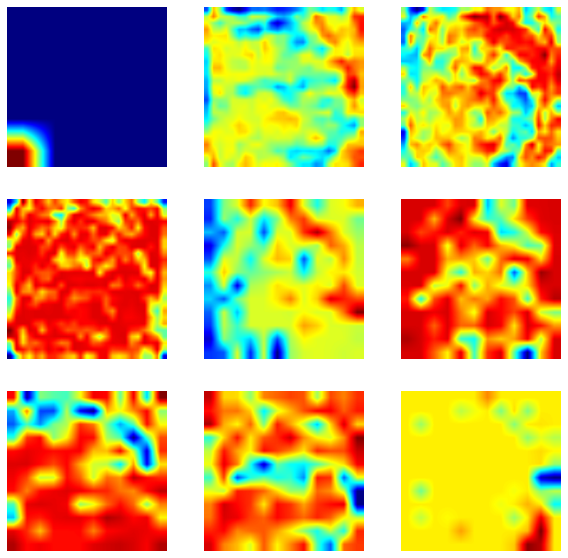

In [21]:
tf.random.set_seed(45)
tf.keras.backend.clear_session()
plot_xais(model, classified_eyes["negatives"], "negatives")

positives: 6 44 84 


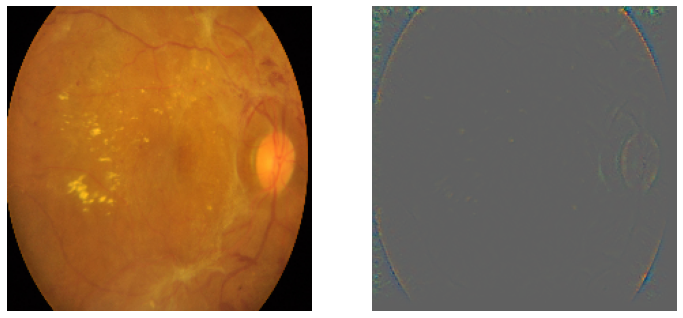

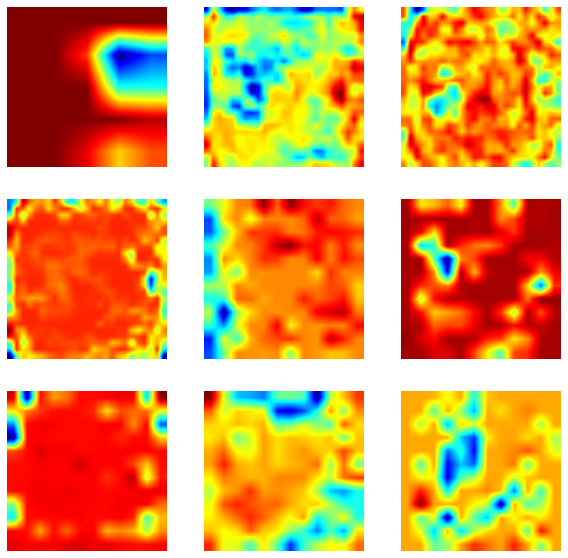

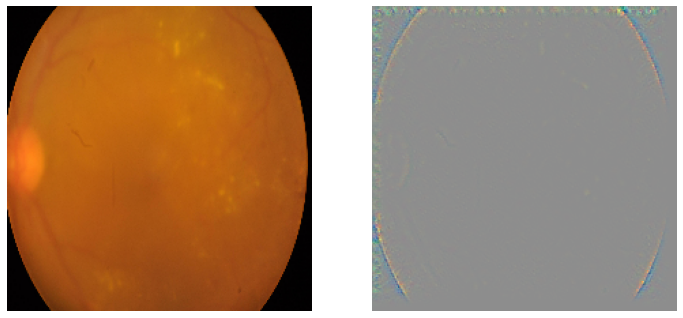

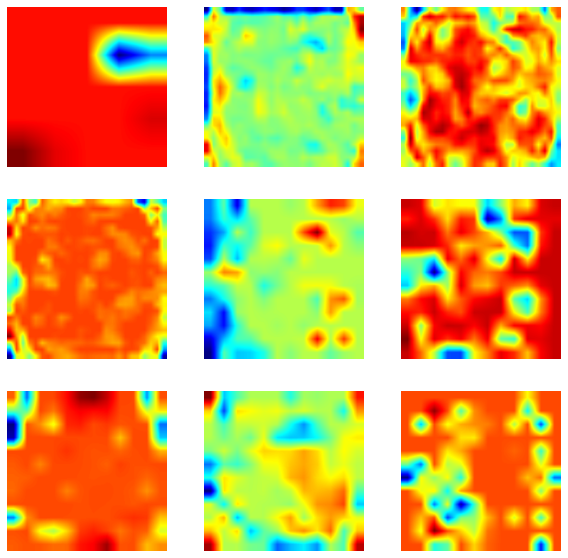

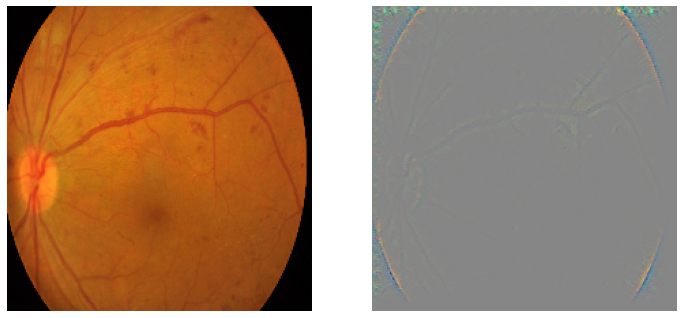

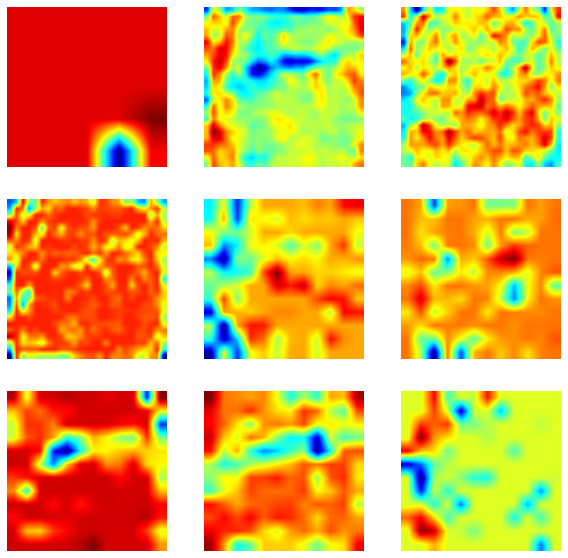

In [22]:
tf.random.set_seed(45)
tf.keras.backend.clear_session()
plot_xais(model, classified_eyes["positives"], "positives",)

fp_eyes: 2 0 

/content/drive/MyDrive/codespace/ann-2022-project/src/xai.py:39: RuntimeWarning: invalid value encountered in true_divide
  heatmap = (grad_cam_img - grad_cam_img.min()) / (grad_cam_img.max() - grad_cam_img.min())


3 


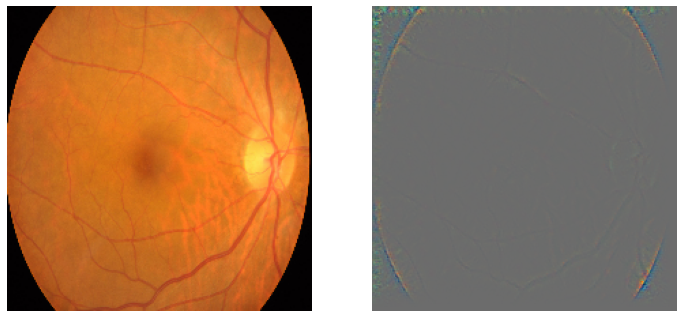

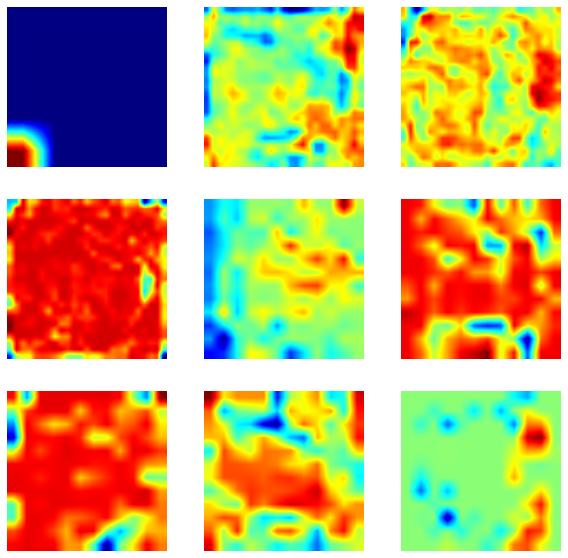

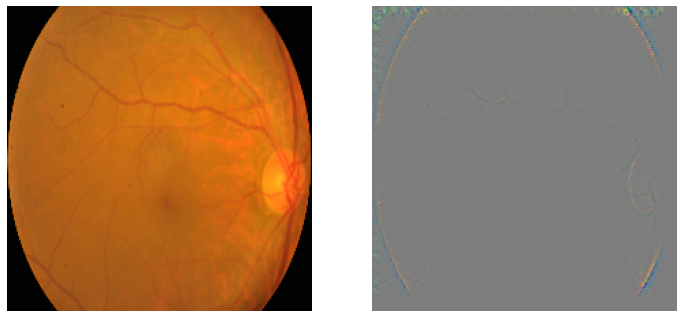

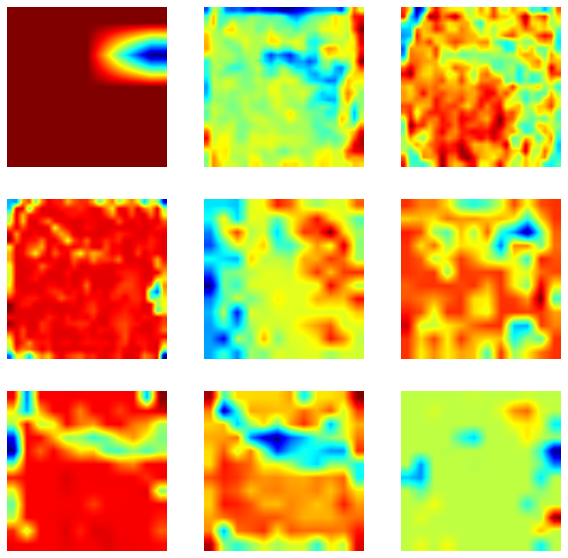

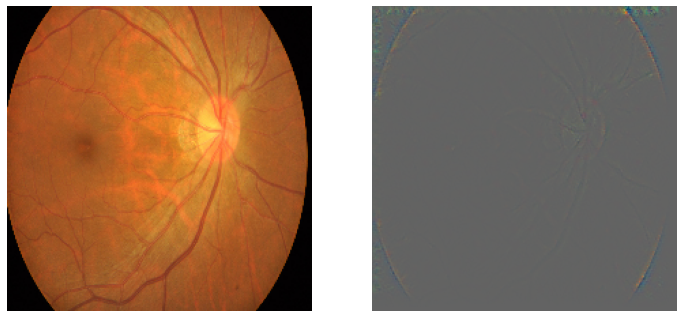

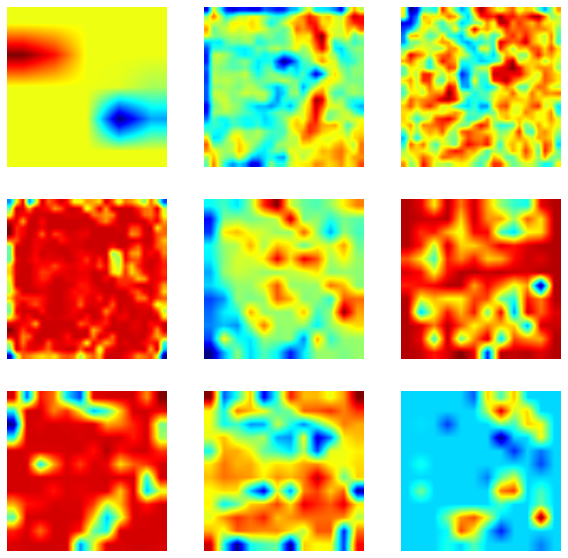

In [23]:
tf.random.set_seed(45)
tf.keras.backend.clear_session()
plot_xais(model, classified_eyes["fp_eyes"], "fp_eyes")

tn_eyes: 1 2 

/content/drive/MyDrive/codespace/ann-2022-project/src/xai.py:39: RuntimeWarning: invalid value encountered in true_divide
  heatmap = (grad_cam_img - grad_cam_img.min()) / (grad_cam_img.max() - grad_cam_img.min())


0 


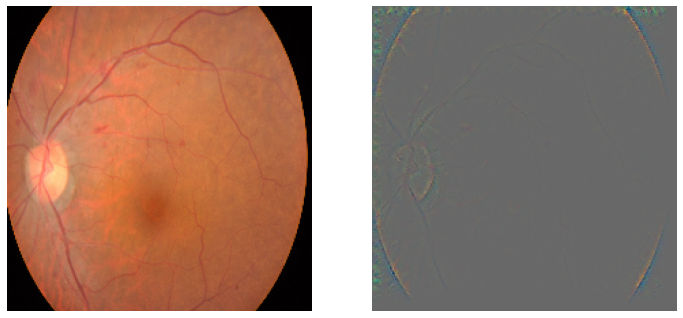

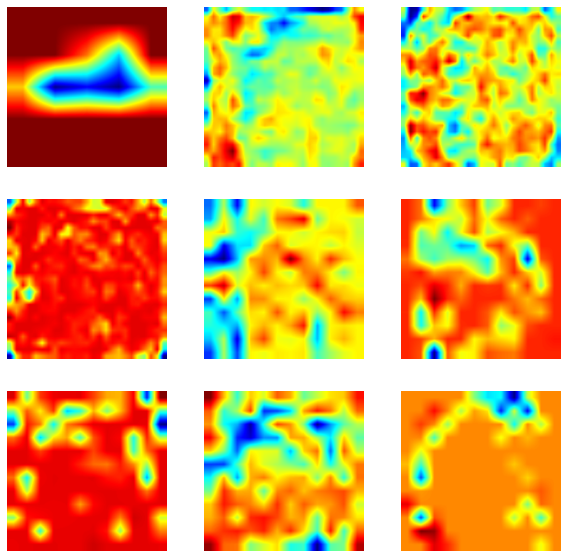

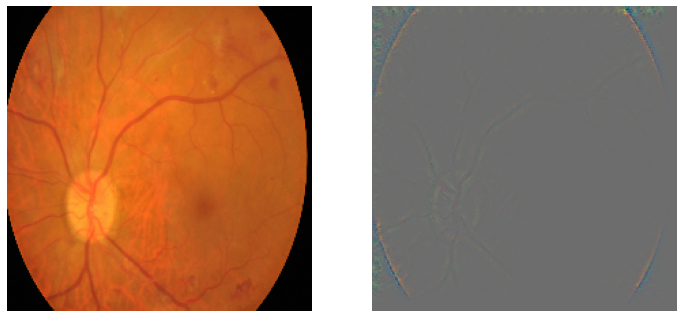

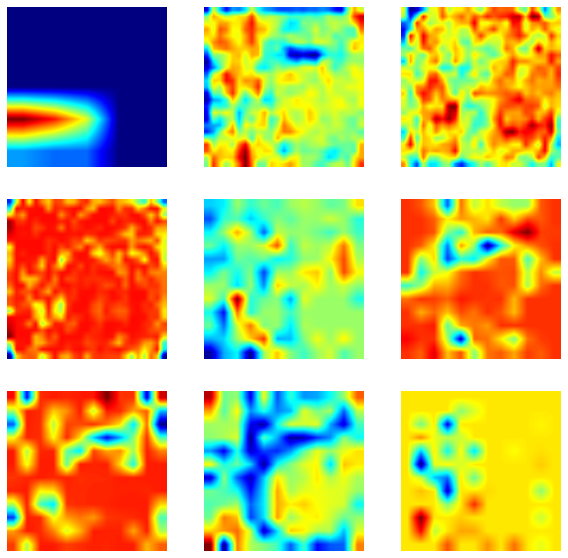

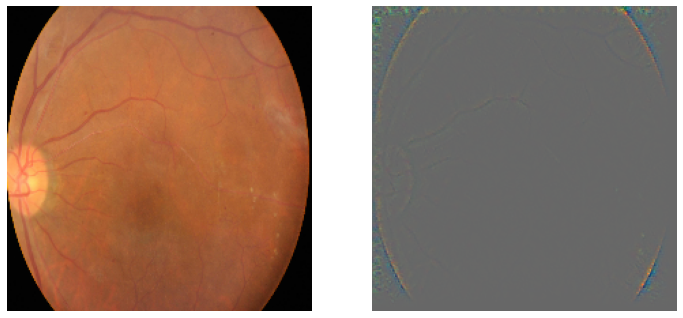

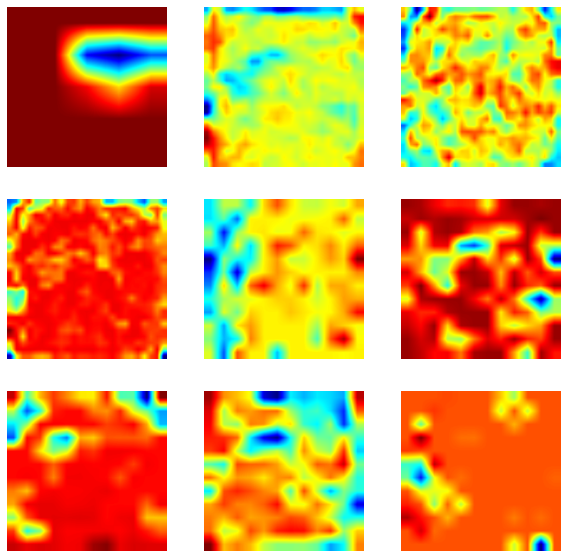

In [24]:
tf.random.set_seed(45)
tf.keras.backend.clear_session()
plot_xais(model, classified_eyes["tn_eyes"], "tn_eyes")

## Fine-tune, No Augmentation

In [32]:
config = Configuration()
tf.random.set_seed(46)
tf.keras.backend.clear_session()

config.use_augmentation = False
config.use_pretrained = True
config.linear_probing = False
model = load_pretrained_googlenet(config)
model_path = "./models/finetune_noaug"
model.load_weights(model_path)

classified_eyes = run_dataset(model, valid_ds)

[[116   0]
 [  1 118]]
              precision    recall  f1-score   support

           0       0.99      1.00      1.00       116
           1       1.00      0.99      1.00       119

    accuracy                           1.00       235
   macro avg       1.00      1.00      1.00       235
weighted avg       1.00      1.00      1.00       235



negatives: 9 87 

/content/drive/MyDrive/codespace/ann-2022-project/src/xai.py:39: RuntimeWarning: invalid value encountered in true_divide
  heatmap = (grad_cam_img - grad_cam_img.min()) / (grad_cam_img.max() - grad_cam_img.min())


66 


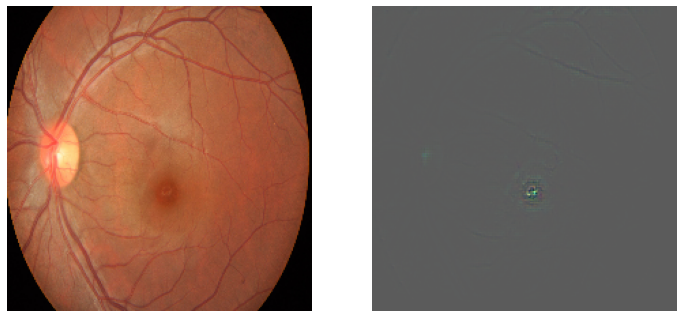

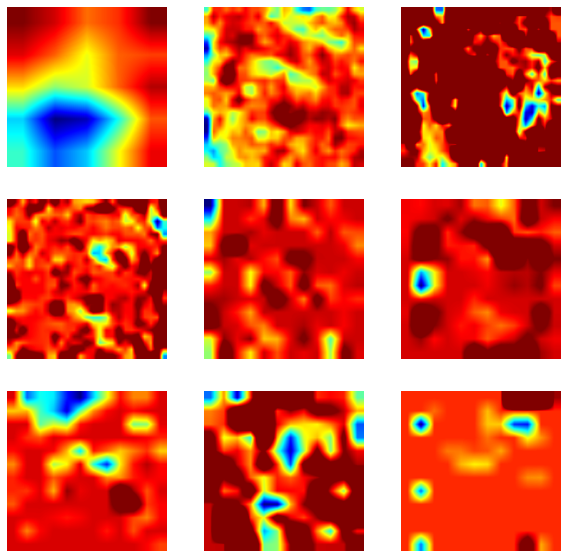

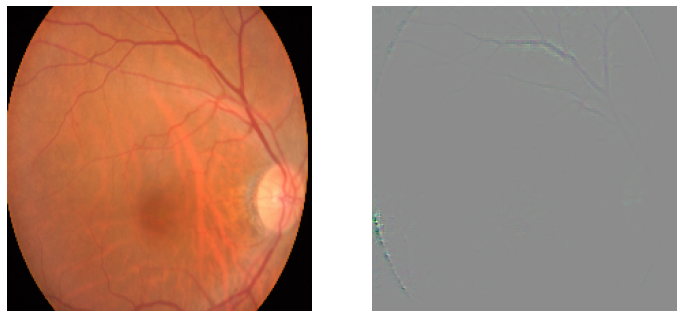

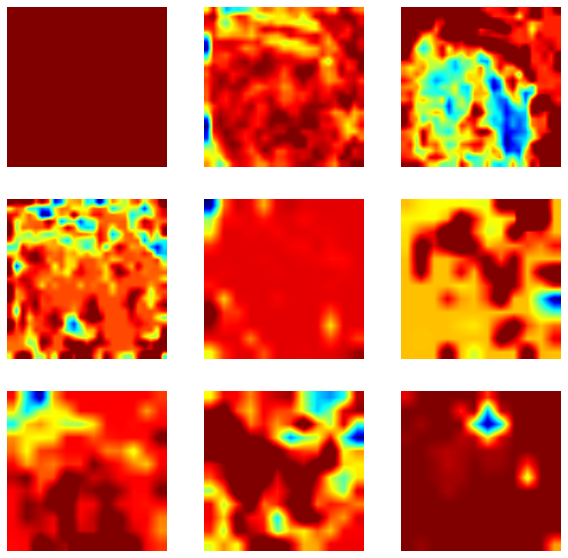

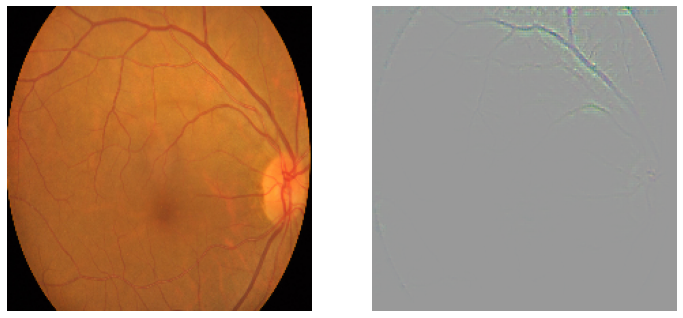

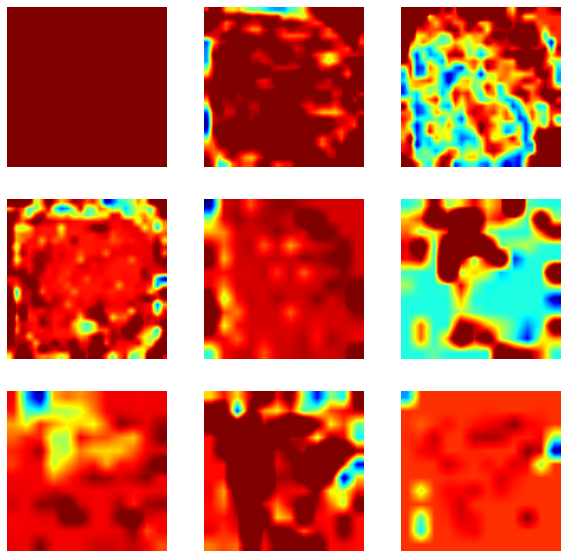

In [33]:
tf.random.set_seed(46)
tf.keras.backend.clear_session()
plot_xais(model, classified_eyes["negatives"], "negatives")

positives: 51 

/content/drive/MyDrive/codespace/ann-2022-project/src/xai.py:39: RuntimeWarning: invalid value encountered in true_divide
  heatmap = (grad_cam_img - grad_cam_img.min()) / (grad_cam_img.max() - grad_cam_img.min())


106 43 


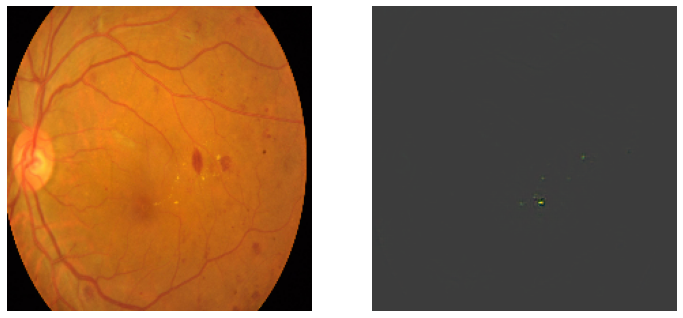

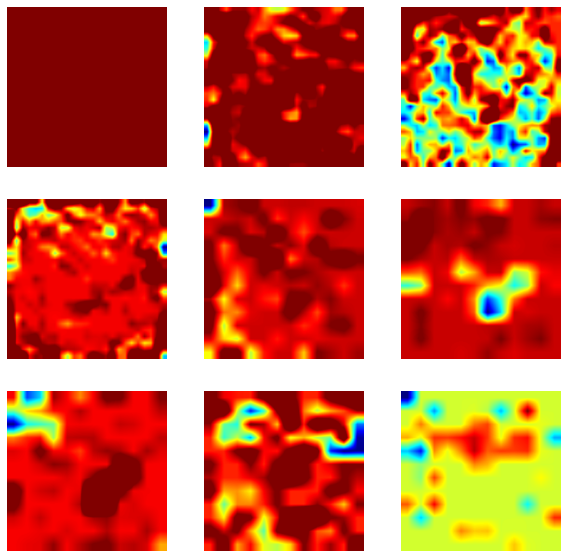

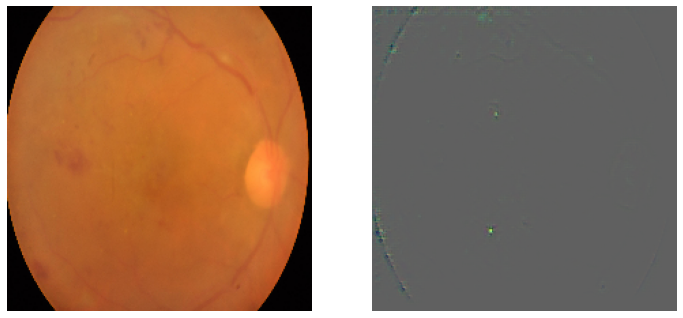

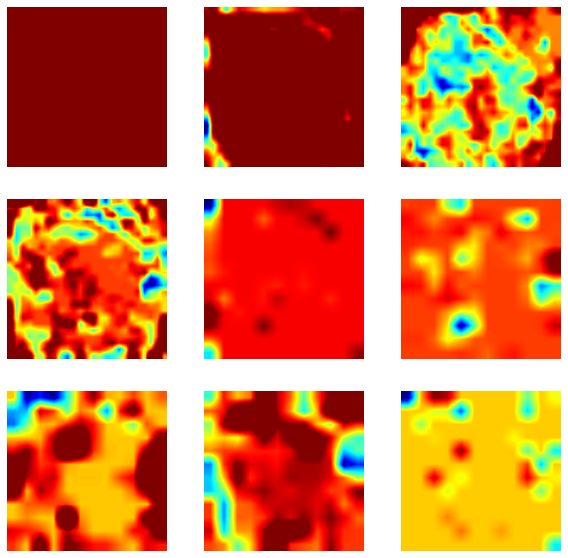

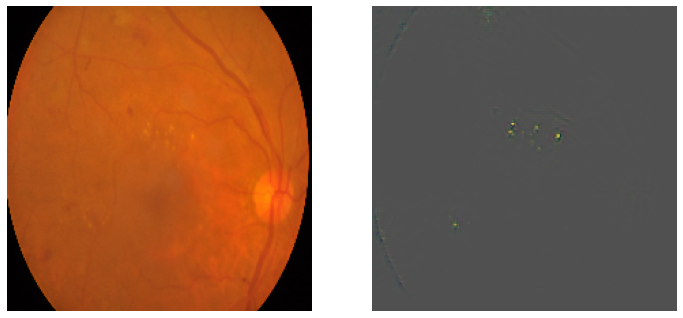

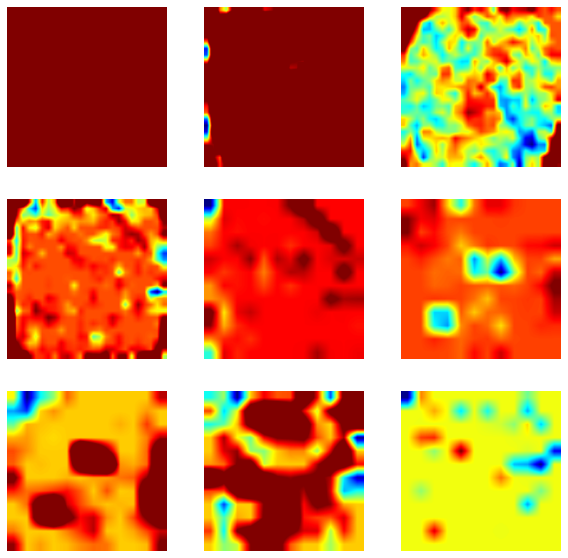

In [34]:
tf.random.set_seed(46)
tf.keras.backend.clear_session()
plot_xais(model, classified_eyes["positives"], "positives")

## Fine-tune, Hard Augmentation

In [26]:
config = Configuration()
tf.random.set_seed(49)
tf.keras.backend.clear_session()

config.use_augmentation = "hard"
config.use_pretrained = True
config.linear_probing = False
model = load_pretrained_googlenet(config)
model_path = "./models/finetune_hardaug"
model.load_weights(model_path)

classified_eyes = run_dataset(model, valid_ds)

[[115   1]
 [  1 118]]
              precision    recall  f1-score   support

           0       0.99      0.99      0.99       116
           1       0.99      0.99      0.99       119

    accuracy                           0.99       235
   macro avg       0.99      0.99      0.99       235
weighted avg       0.99      0.99      0.99       235



negatives: 27 33 81 

/content/drive/MyDrive/codespace/ann-2022-project/src/xai.py:39: RuntimeWarning: invalid value encountered in true_divide
  heatmap = (grad_cam_img - grad_cam_img.min()) / (grad_cam_img.max() - grad_cam_img.min())


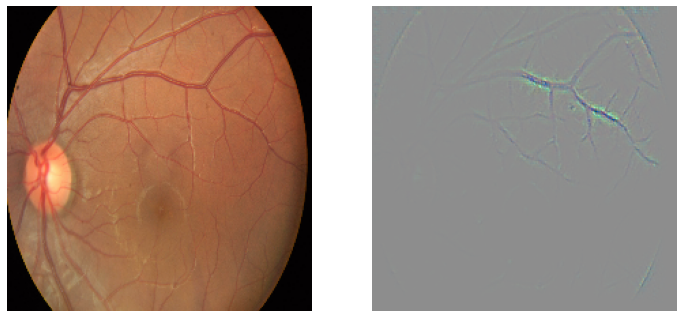

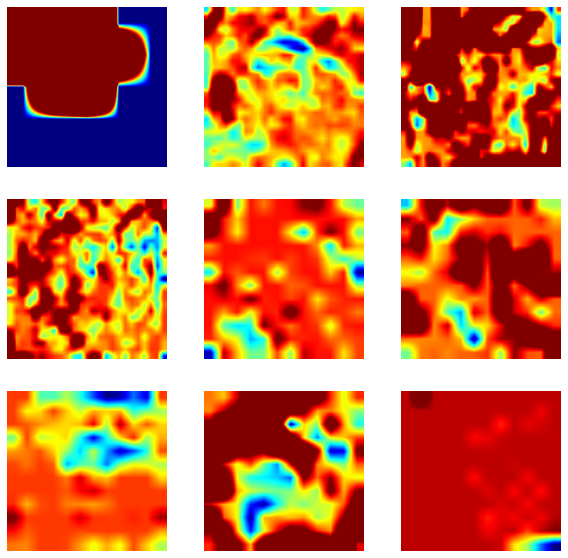

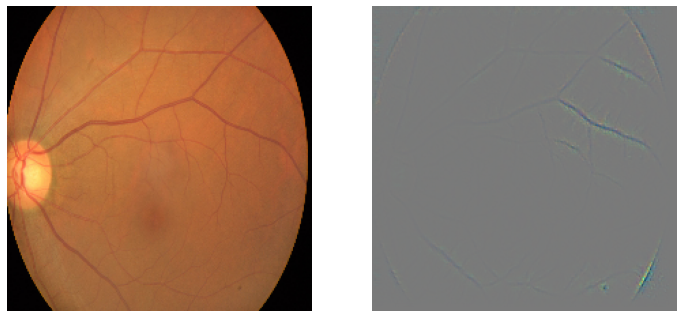

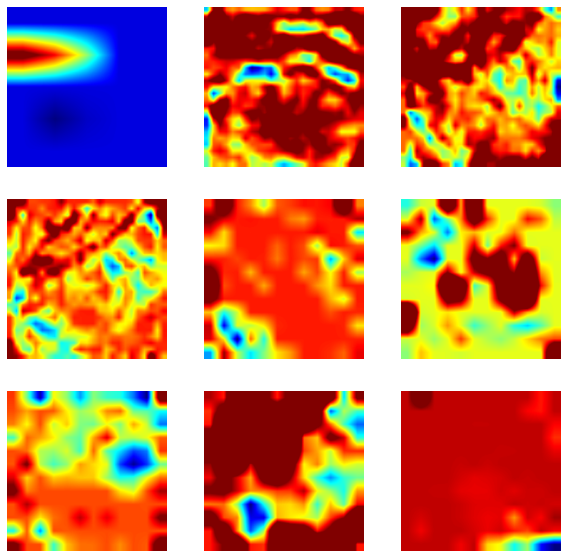

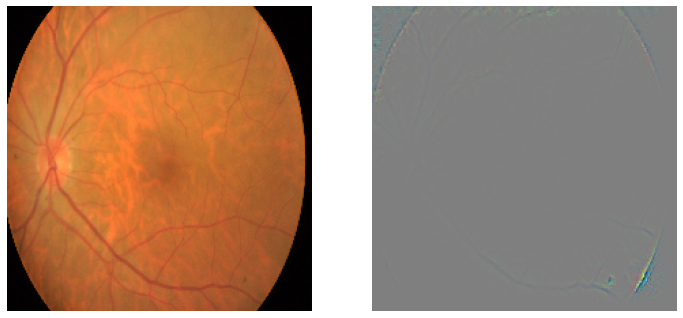

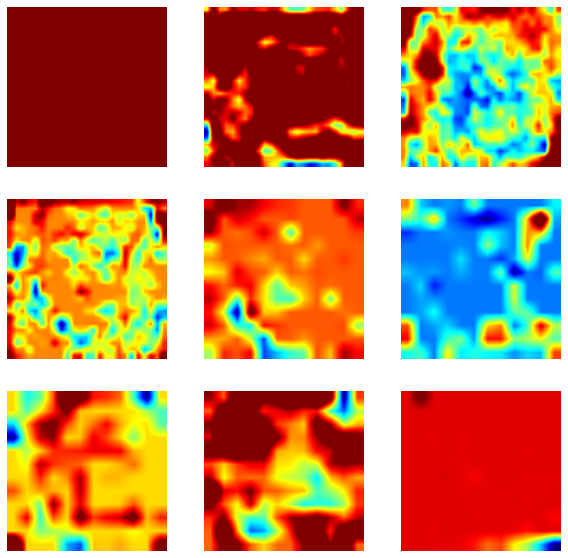

In [27]:
tf.random.set_seed(49)
tf.keras.backend.clear_session()
plot_xais(model, classified_eyes["negatives"], "negatives")

positives: 107 

/content/drive/MyDrive/codespace/ann-2022-project/src/xai.py:39: RuntimeWarning: invalid value encountered in true_divide
  heatmap = (grad_cam_img - grad_cam_img.min()) / (grad_cam_img.max() - grad_cam_img.min())


93 109 


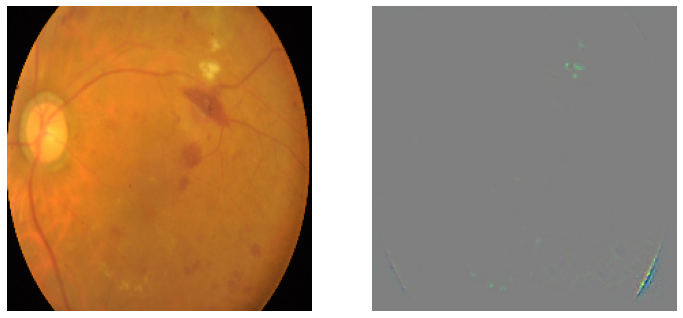

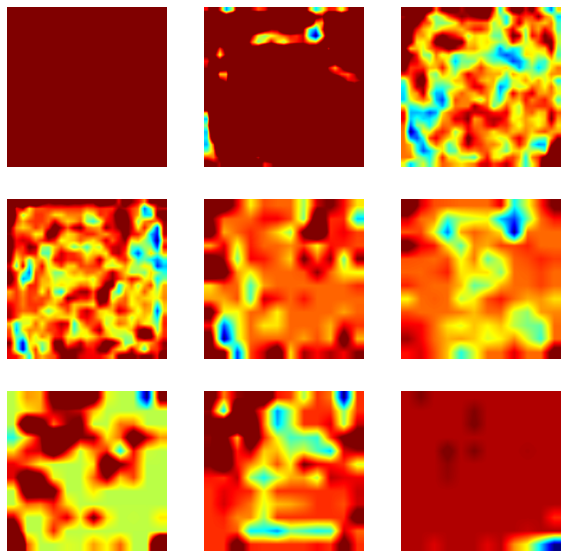

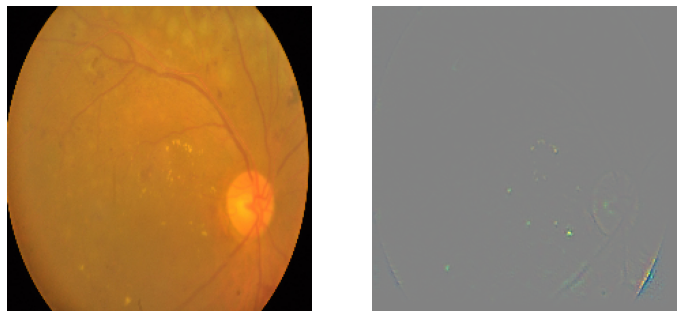

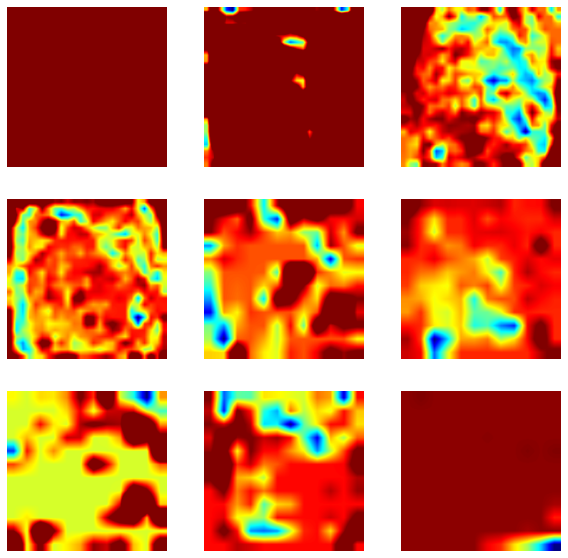

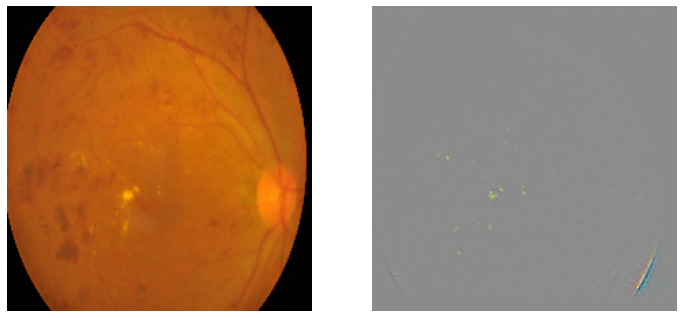

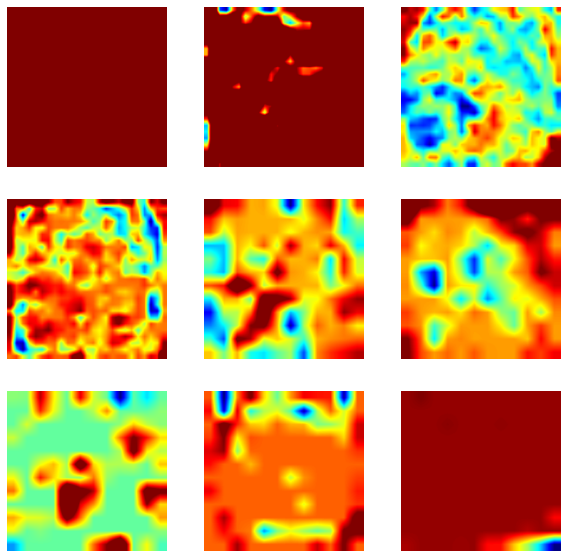

In [28]:
tf.random.set_seed(49)
tf.keras.backend.clear_session()
plot_xais(model, classified_eyes["positives"], "positives")

fp_eyes: 0 

/content/drive/MyDrive/codespace/ann-2022-project/src/xai.py:39: RuntimeWarning: invalid value encountered in true_divide
  heatmap = (grad_cam_img - grad_cam_img.min()) / (grad_cam_img.max() - grad_cam_img.min())


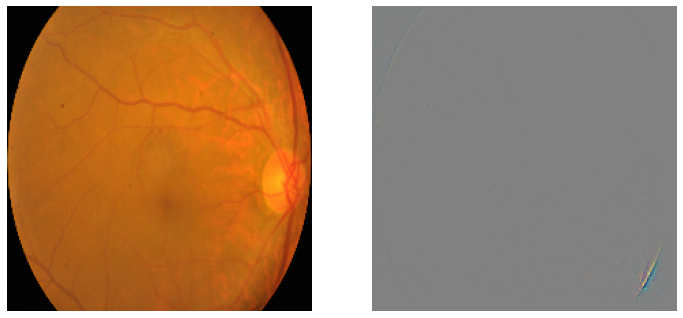

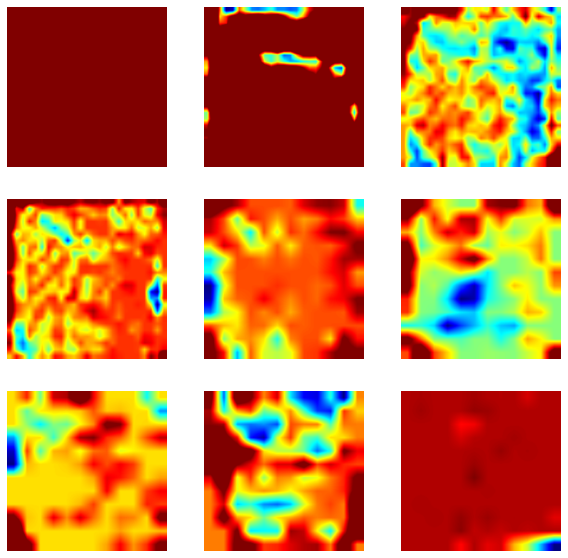

In [29]:
tf.random.set_seed(49)
tf.keras.backend.clear_session()
plot_xais(model, classified_eyes["fp_eyes"], "fp_eyes")

tn_eyes: 0 


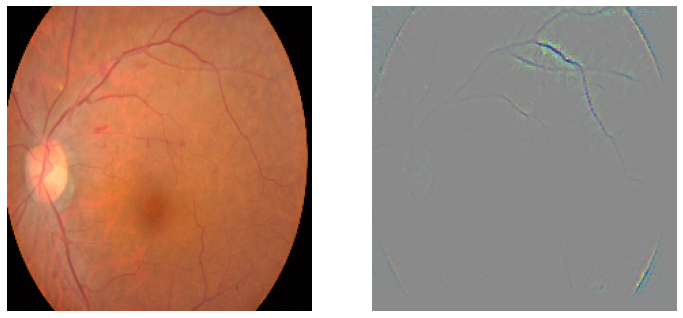

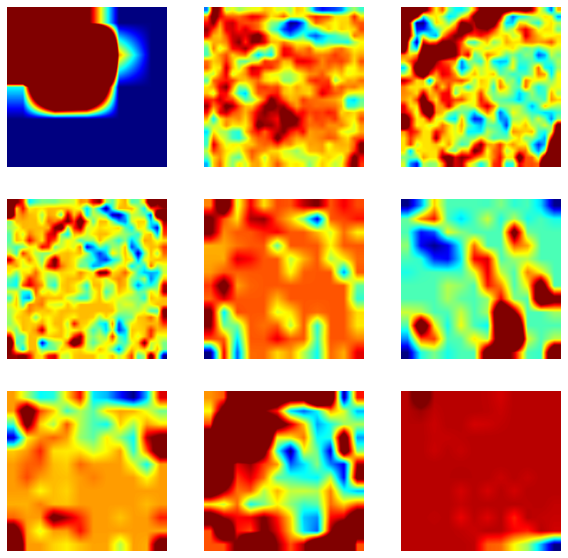

In [30]:
tf.random.set_seed(49)
tf.keras.backend.clear_session()
plot_xais(model, classified_eyes["tn_eyes"], "tn_eyes")